In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline 
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [2]:
data = pd.read_csv('C:/Users/Hamish/Downloads/Telco-Customer-Churn.csv')
data.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,...,Yes,No,No,No,One year,No,Mailed check,56.95,1889.50,No
2,3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,...,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,...,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes


In [3]:
data.shape

(7032, 21)

In [4]:
data.columns

Index(['customerID', 'gender', 'SeniorCitizen', 'Partner', 'Dependents',
       'tenure', 'PhoneService', 'MultipleLines', 'InternetService',
       'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport',
       'StreamingTV', 'StreamingMovies', 'Contract', 'PaperlessBilling',
       'PaymentMethod', 'MonthlyCharges', 'TotalCharges', 'Churn'],
      dtype='object')

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7032 entries, 0 to 7031
Data columns (total 21 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   customerID        7032 non-null   object 
 1   gender            7032 non-null   object 
 2   SeniorCitizen     7032 non-null   int64  
 3   Partner           7032 non-null   object 
 4   Dependents        7032 non-null   object 
 5   tenure            7032 non-null   int64  
 6   PhoneService      7032 non-null   object 
 7   MultipleLines     7032 non-null   object 
 8   InternetService   7032 non-null   object 
 9   OnlineSecurity    7032 non-null   object 
 10  OnlineBackup      7032 non-null   object 
 11  DeviceProtection  7032 non-null   object 
 12  TechSupport       7032 non-null   object 
 13  StreamingTV       7032 non-null   object 
 14  StreamingMovies   7032 non-null   object 
 15  Contract          7032 non-null   object 
 16  PaperlessBilling  7032 non-null   object 


In [6]:
data.isnull().sum()

customerID          0
gender              0
SeniorCitizen       0
Partner             0
Dependents          0
tenure              0
PhoneService        0
MultipleLines       0
InternetService     0
OnlineSecurity      0
OnlineBackup        0
DeviceProtection    0
TechSupport         0
StreamingTV         0
StreamingMovies     0
Contract            0
PaperlessBilling    0
PaymentMethod       0
MonthlyCharges      0
TotalCharges        0
Churn               0
dtype: int64

In [7]:
# No Null Values!

In [8]:
data.describe()

,SeniorCitizen,tenure,MonthlyCharges,TotalCharges
count,7032.000000,7032.000000,7032.000000,7032.000000
mean,0.162400,32.421786,64.798208,2283.300441
std,0.368844,24.545260,30.085974,2266.771362
min,0.000000,1.000000,18.250000,18.800000
25%,0.000000,9.000000,35.587500,401.450000
50%,0.000000,29.000000,70.350000,1397.475000
75%,0.000000,55.000000,89.862500,3794.737500
max,1.000000,72.000000,118.750000,8684.800000


In [9]:
data.drop(columns = 'customerID', inplace = True)

In [10]:
# label encoding to transform categorical features.
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()

df1 = data.copy(deep = True)
text_data_features = [i for i in list(data.columns) if i not in list(data.describe().columns)]
print('Label Encoder Transformation')
for i in text_data_features:
    df1[i] = le.fit_transform(df1[i])
    print(i, ' : ,', df1[i].unique(), '=' , le.inverse_transform(df1[i].unique()))

Label Encoder Transformation
gender  : , [0 1] = ['Female' 'Male']
Partner  : , [1 0] = ['Yes' 'No']
Dependents  : , [0 1] = ['No' 'Yes']
PhoneService  : , [0 1] = ['No' 'Yes']
MultipleLines  : , [1 0 2] = ['No phone service' 'No' 'Yes']
InternetService  : , [0 1 2] = ['DSL' 'Fiber optic' 'No']
OnlineSecurity  : , [0 2 1] = ['No' 'Yes' 'No internet service']
OnlineBackup  : , [2 0 1] = ['Yes' 'No' 'No internet service']
DeviceProtection  : , [0 2 1] = ['No' 'Yes' 'No internet service']
TechSupport  : , [0 2 1] = ['No' 'Yes' 'No internet service']
StreamingTV  : , [0 2 1] = ['No' 'Yes' 'No internet service']
StreamingMovies  : , [0 2 1] = ['No' 'Yes' 'No internet service']
Contract  : , [0 1 2] = ['Month-to-month' 'One year' 'Two year']
PaperlessBilling  : , [1 0] = ['Yes' 'No']
PaymentMethod  : , [2 3 0 1] = ['Electronic check' 'Mailed check' 'Bank transfer (automatic)'
 'Credit card (automatic)']
Churn  : , [0 1] = ['No' 'Yes']


- We are creating a deep copy of the orginal dataset and label encoding the text data.
- Modifications in the original dataset will not be highlighted in this deep copy.
- Hence, we use this deep copy of dataset that has all the features converted into numerical values for visualization & modeling purposes.
- We now again the see descriptive stats of the data.

In [11]:
df1.describe()

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
count,7032.000000,7032.000000,7032.000000,7032.000000,7032.000000,7032.000000,7032.000000,7032.000000,7032.000000,7032.000000,7032.000000,7032.000000,7032.000000,7032.000000,7032.000000,7032.000000,7032.000000,7032.000000,7032.000000,7032.000000
mean,0.504693,0.162400,0.482509,0.298493,32.421786,0.903299,0.940557,0.872582,0.789249,0.905859,0.903868,0.796359,0.984926,0.992890,0.688567,0.592719,1.573237,64.798208,2283.300441,0.265785
std,0.500014,0.368844,0.499729,0.457629,24.545260,0.295571,0.948627,0.737271,0.859962,0.880394,0.880178,0.861674,0.885285,0.885385,0.832934,0.491363,1.067504,30.085974,2266.771362,0.441782
min,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.250000,18.800000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,9.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,35.587500,401.450000,0.000000
50%,1.000000,0.000000,0.000000,0.000000,29.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,2.000000,70.350000,1397.475000,0.000000
75%,1.000000,0.000000,1.000000,1.000000,55.000000,1.000000,2.000000,1.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,1.000000,1.000000,2.000000,89.862500,3794.737500,1.000000
max,1.000000,1.000000,1.000000,1.000000,72.000000,1.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,1.000000,3.000000,118.750000,8684.800000,1.000000


In [12]:
colors = ['#E94B3C','#2D2926']

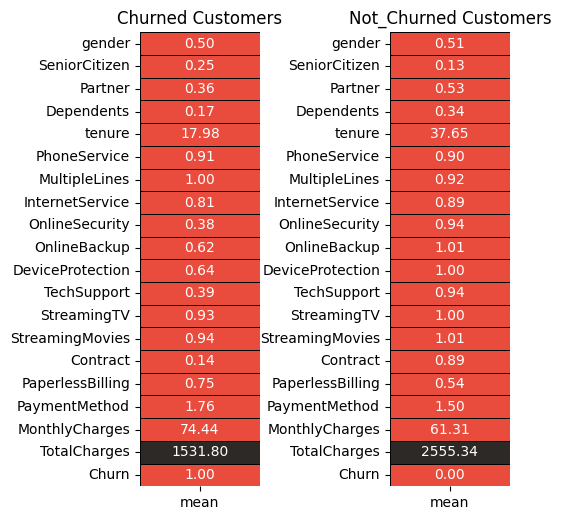

In [14]:
churn = df1[df1['Churn'] == 1].describe().T
not_churn = df1[df1['Churn'] == 0].describe().T

fig,ax = plt.subplots(nrows = 1,ncols = 2,figsize = (5,5))
plt.subplot(1,2,1)
sns.heatmap(churn[['mean']],annot = True,cmap = colors,linewidths = 0.4,linecolor = 'black',cbar = False,fmt = '.2f')
plt.title('Churned Customers');

plt.subplot(1,2,2)
sns.heatmap(not_churn[['mean']],annot = True,cmap = colors,linewidths = 0.4,linecolor = 'black',cbar = False,fmt = '.2f',)
plt.title('Not_Churned Customers');

fig.tight_layout(pad = 0)

- Mean values of all the features for churned and not-churned customers.
- Clearly, the customers that churned had a low mean tenure of 17.98 months as compared to those who continued with an average   tenure period of 37.57 months.
- Mean values of OnlineSecurity, OnlineBackup, DeviceProtection and TechSupport are higher for not-churned customers than churn customers. This can serve as a good indicator or point to focus on!
- Churned customer's Contract value is much smaller than those of not-churned customers.
- Mean MonthlyCharges of the churn customers, 74.44, is more than that of not-churn customers, 61.27.
- Not-churned customers TotalCharges, 2557.31, is higher than churn customers, 1531.80.
- From these mean values, we can say that some of the features display a clear cut difference that can help to focus more churn customers to make sure they retain the services.
- The dataset has too many categorical features, hence mean values of the features are present in the vicinity of 0.

# Exploratory Data Analysis


**Dividing features into Numerical and Categorical :**

In [16]:
col = list(df1.columns)
categorical_features = []
numerical_features = []
for i in col:
    if len(data[i].unique()) > 6:
        numerical_features.append(i)
    else:
        categorical_features.append(i)

print('Categorical Features :',*categorical_features)
print('Numerical Features :',*numerical_features)

Categorical Features : gender SeniorCitizen Partner Dependents PhoneService MultipleLines InternetService OnlineSecurity OnlineBackup DeviceProtection TechSupport StreamingTV StreamingMovies Contract PaperlessBilling PaymentMethod Churn
Numerical Features : tenure MonthlyCharges TotalCharges


- Categorical Features : gender, SeniorCitizen, Partner, Dependents, PhoneService, MultipleLines, InternetService, OnlineSecurity, OnlineBackup, DeviceProtection, TechSupport, StreamingTV, StreamingMovies, Contract, PaperlessBilling, PaymentMethod, Churn.
- Numerical Features : tenure, MonthlyCharges, TotalCharges.

Target Variable Visualization (Churn) :

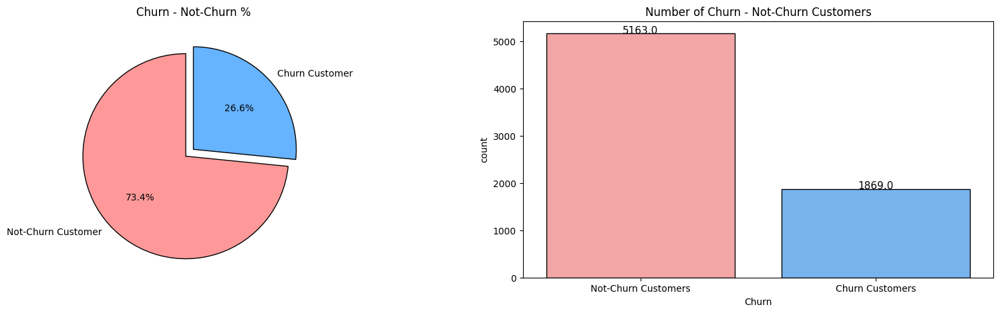

In [19]:
l = list(df1['Churn'].value_counts())
circle = [l[0] / sum(l) * 100, l[1] / sum(l) * 100]

colors = ['#ff9999','#66b3ff']  # Define the colors

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20, 5))

# Pie chart
axes[0].pie(circle, labels=['Not-Churn Customer', 'Churn Customer'], autopct='%1.1f%%', startangle=90,
            explode=(0.1, 0), colors=colors, wedgeprops={'edgecolor': 'black', 'linewidth': 1, 'antialiased': True})
axes[0].set_title('Churn - Not-Churn %')

# Count plot
ax = sns.countplot(x='Churn', data=df1, palette=colors, edgecolor='black', ax=axes[1])
for rect in ax.patches:
    height = rect.get_height()
    ax.text(rect.get_x() + rect.get_width() / 2, height + 2, height, ha='center', fontsize=11)
ax.set_xticklabels(['Not-Churn Customers', 'Churn Customers'])
axes[1].set_title('Number of Churn - Not-Churn Customers')

plt.show()

- The dataset is unbalanced in a near about 4 : 1 ratio for Not-Churn : Churn customers!
- Due to this, predictions will be biased towards Not-Churn customers.

In [20]:
categorical_features.remove('Churn')

- I removed Churn, target variable, from the categorical features list for visualization purposes.

In [21]:
l1 = ['gender','SeniorCitizen','Partner','Dependents'] # Customer Information
l2 = ['PhoneService','MultipleLines','InternetService','StreamingTV','StreamingMovies',
      'OnlineSecurity','OnlineBackup','DeviceProtection','TechSupport'] # Services Signed Up for!
l3 = ['Contract','PaperlessBilling','PaymentMethod'] # Payment Information

- There are too many categorical features in this dataset!
- So, divided them into 3 groups depending on their values or based on the column name!

Group 1 : Customer Information :
gender | SeniorCitizen | Partner | Dependents |

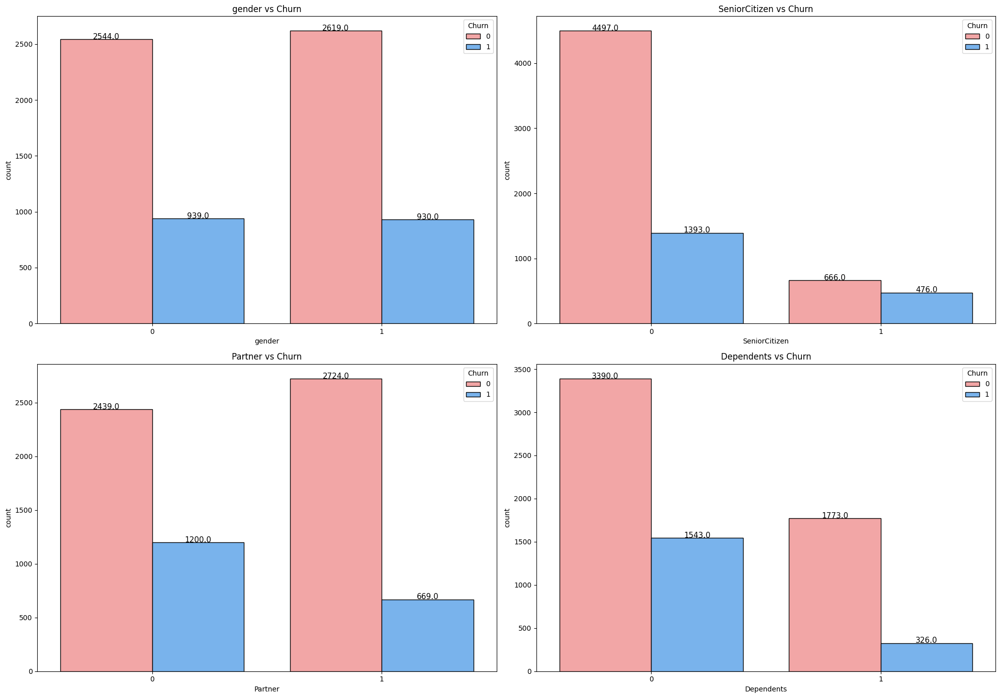

In [26]:
olors = ['#ff9999','#66b3ff'] 

fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20, 14))

for i in range(len(l1)):
    plt.subplot(2, 2, i + 1)
    ax = sns.countplot(x=l1[i], data=df1, hue='Churn', palette=colors, edgecolor='black')
    for rect in ax.patches:
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width() / 2, height + 2, height, ha='center', fontsize=11)
    title = l1[i] + ' vs Churn'
    plt.title(title)

plt.tight_layout()
plt.show()

- Customer churning for male & female customers is very similar to each other!
Similarly, number of SeniorCitizen customers is pretty low! Out of that, we can observe a near about 40% churn of SeniorCitizen customers. It accounts for a total of 476 customers out of 1142 Senior Citizen customers.

- Customers who are housing with a Partner churned less as compared to those not living with a Partner.
Similary, churning is high for the customers that don't have Dependents with them!

- Group 2: Services Subscribed by the Customer :

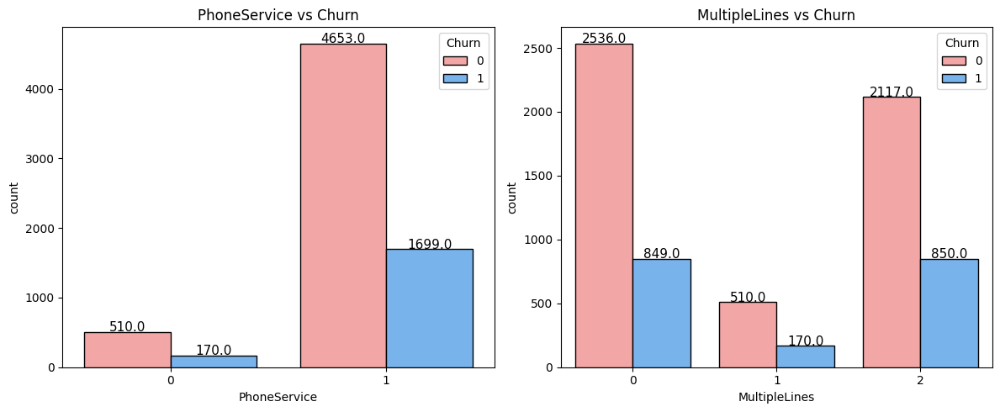

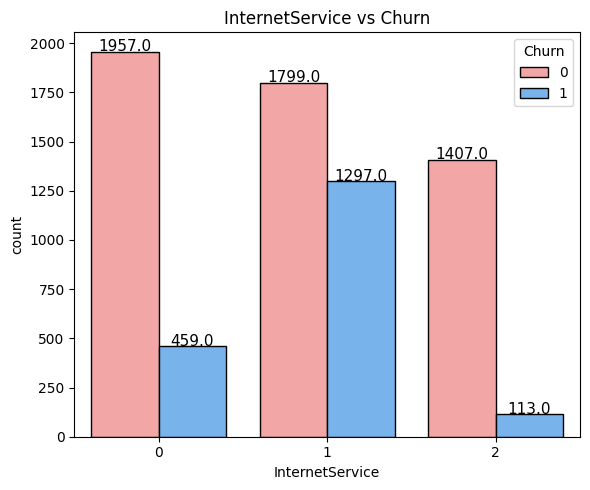

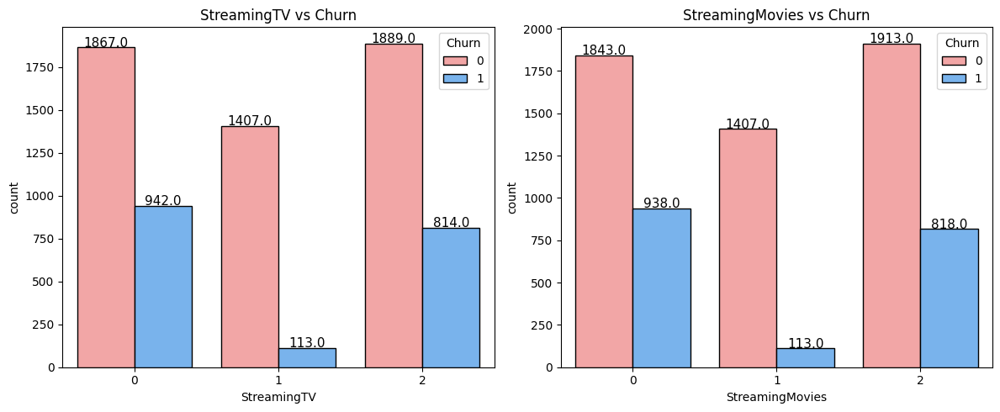

In [30]:
colors = ['#ff9999','#66b3ff'] 

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))
for i in range(2):
    ax = sns.countplot(x=l2[i], data=df1, hue='Churn', palette=colors, edgecolor='black', ax=axes[i])
    for rect in ax.patches:
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width() / 2, height + 2, height, ha='center', fontsize=11)
    title = l2[i] + ' vs Churn'
    axes[i].set_title(title)

plt.tight_layout()
plt.show()

# Single subplot (InternetService)
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(6, 5))
ax = sns.countplot(x=l2[2], data=df1, hue='Churn', palette=colors, edgecolor='black', ax=ax)
for rect in ax.patches:
    height = rect.get_height()
    ax.text(rect.get_x() + rect.get_width() / 2, height + 2, height, ha='center', fontsize=11)
title = l2[2] + ' vs Churn'
ax.set_title(title)

plt.tight_layout()
plt.show()

# Second set of subplots (StreamingTV, StreamingMovies)
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))
for i in range(2):
    ax = sns.countplot(x=l2[i + 3], data=df1, hue='Churn', palette=colors, edgecolor='black', ax=axes[i])
    for rect in ax.patches:
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width() / 2, height + 2, height, ha='center', fontsize=11)
    title = l2[i + 3] + ' vs Churn'
    axes[i].set_title(title)

plt.tight_layout()
plt.show()

- For PhoneService, despite having no phone service, more customers were retained as compared to the number of customers who dropped the services.
- In case of MultipleLines, churn rate in when the Multiplelines are present or not is the same.
- A high number of customers have displayed their resistance towards the use of Fiber optic cables for providing the InternetService. On the contrary, from the above graph, customers prefer using DSL for their InternetService!
- StreamingTV and StreamingMovies display an identical graph. Irrespective of being subscribed to StreamingTV & StreamingMovies, a lot of customers have been churned. Looks like the streaming content was not entirely at fault!

- Services Subscribed by the Customer :
OnlineSecurity | OnlineBackup | DeviceProtection | TechSupport |

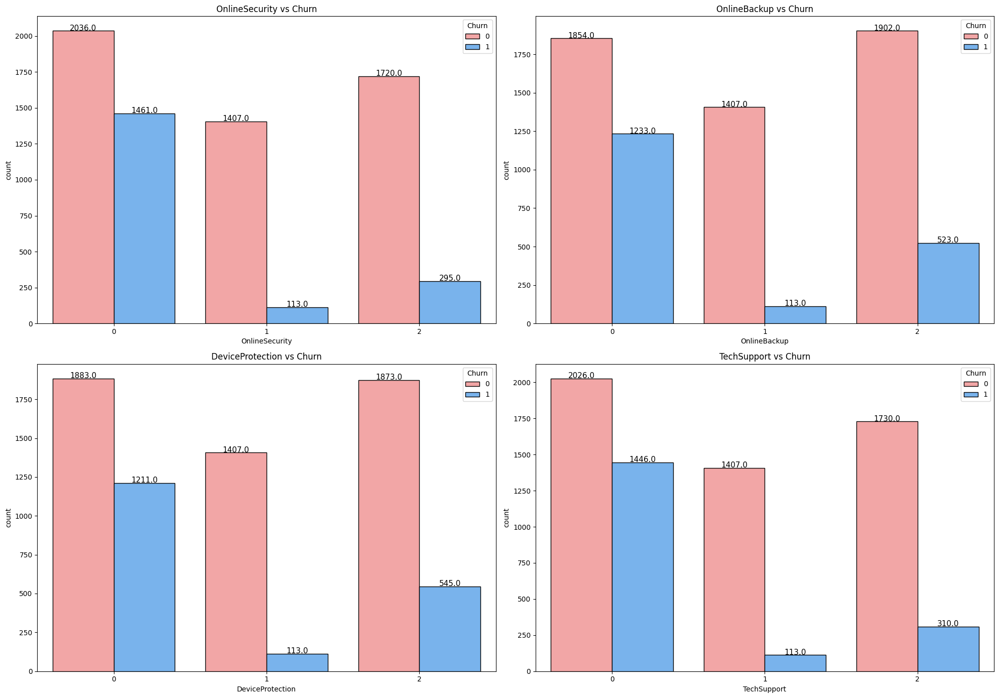

In [33]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20, 14))
for i in range(4):
    ax = sns.countplot(x=l2[-4 + i], data=df1, hue='Churn', palette=colors, edgecolor='black', ax=axes[i//2, i%2])
    for rect in ax.patches:
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width() / 2, height + 2, height, ha='center', fontsize=11)
    title = l2[-4 + i] + ' vs Churn'
    ax.set_title(title)

plt.tight_layout()
plt.show()


- When it comes down to catering the customers, services w.r.t OnlineSecurity, OnlineBackup, DeviceProtection & TechSupport are crucial from the above visualizations!
- A high number of customers have switched their service provider when it comes down poor services with the above mentioned features.

- Group 3 : Contract | PaperlessBilling | PaymentMethod |

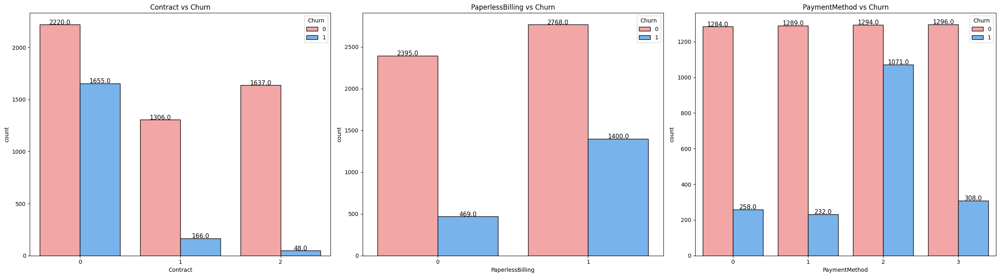

In [35]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(25, 7))

# Plot each feature in l3
for i in range(3):
    ax = sns.countplot(x=l3[i], data=df1, hue='Churn', palette=colors, edgecolor='black', ax=axes[i])
    for rect in ax.patches:
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width() / 2, height + 2, height, ha='center', fontsize=11)
    title = l3[i] + ' vs Churn'
    ax.set_title(title)

plt.tight_layout()
plt.show()

- Customer churning for a Month-to-Month based Contract is quite high. This is probably because the customers are testing out the varied services available to them and hence, in order to save money, 1 month service is tested out!
- Another reason can be the overall experience with the internet service, streaming service and phone service were not consistent. Every customer has a different priority and hence if one of the 3 was upto par, the entire service was cutoff!
- PaperlessBilling displays a high number of customers being churned out. This is probably because of some payment issue or receipt issues.
- Customers clearly resented the Electronic check PaymentMethod. Out of the 2365 number of bills paid using Electronic check, a staggering 1071 customers exited the pool of service due to this payment method. Company definitely needs to either drop Electronic check method or make it hassle-free and user-friendly.

# Feature Engineering


In [37]:
mms = MinMaxScaler()  # Normalization
ss = StandardScaler()  # Standardization

# Drop unnecessary columns if they exist
columns_to_drop = ['MonthlyCharges_Group', 'TotalCharges_Group']
df1.drop(columns=[col for col in columns_to_drop if col in df1.columns], inplace=True)

# Normalize specific columns
columns_to_normalize = ['tenure', 'MonthlyCharges', 'TotalCharges']
df1[columns_to_normalize] = mms.fit_transform(df1[columns_to_normalize])

# Display the first few rows of the dataframe
print(df1.head())

   gender  SeniorCitizen  Partner  Dependents    tenure  PhoneService  \
0       0              0        1           0  0.000000             0   
1       1              0        0           0  0.464789             1   
2       1              0        0           0  0.014085             1   
3       1              0        0           0  0.619718             0   
4       0              0        0           0  0.014085             1   

   MultipleLines  InternetService  OnlineSecurity  OnlineBackup  \
0              1                0               0             2   
1              0                0               2             0   
2              0                0               2             2   
3              1                0               2             0   
4              0                1               0             0   

   DeviceProtection  TechSupport  StreamingTV  StreamingMovies  Contract  \
0                 0            0            0                0         0   
1     

- Correlation to Churn:

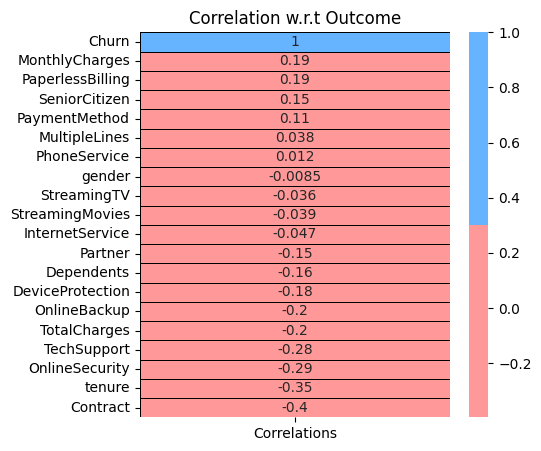

In [38]:
corr = df1.corrwith(df1['Churn']).sort_values(ascending = False).to_frame()
corr.columns = ['Correlations']
plt.subplots(figsize = (5,5))
sns.heatmap(corr,annot = True,cmap = colors,linewidths = 0.4,linecolor = 'black');
plt.title('Correlation w.r.t Outcome');

- MulipleLines, PhoneService, gender, StreamingTV, StreamingMovies and InternetService does not display any kind of correlation. 

- I drop the features with correlation coefficient between (-0.1,0.1).
- Remaining features either display a significant positive or negative correlation.

Feature Selection for Categorical Features :

In [39]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2,mutual_info_classif

Chi-Squared Test :

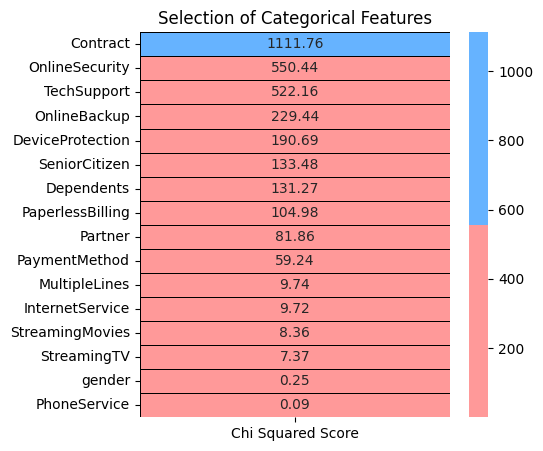

In [40]:
features = df1.loc[:,categorical_features]
target = df1.loc[:,'Churn']

best_features = SelectKBest(score_func = chi2,k = 'all')
fit = best_features.fit(features,target)

featureScores = pd.DataFrame(data = fit.scores_,index = list(features.columns),columns = ['Chi Squared Score']) 

plt.subplots(figsize = (5,5))
sns.heatmap(featureScores.sort_values(ascending = False,by = 'Chi Squared Score'),annot = True,cmap = colors,linewidths = 0.4,linecolor = 'black',fmt = '.2f');
plt.title('Selection of Categorical Features');

- PhoneService, gender, StreamingTV, StreamingMovies, MultipleLines and InternetService display a very low relation with Churn.

Feature Selection for Numerical Features :

In [41]:
from sklearn.feature_selection import f_classif

ANOVA Test :

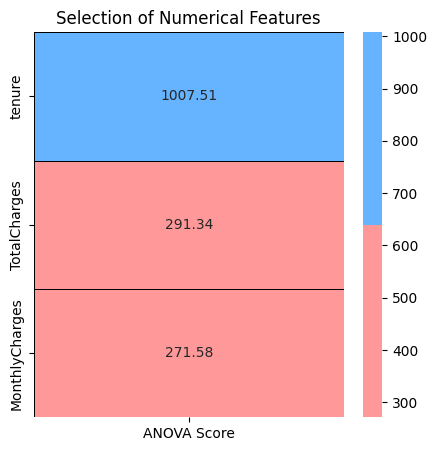

In [42]:
features = df1.loc[:,numerical_features]
target = df1.loc[:,'Churn']

best_features = SelectKBest(score_func = f_classif,k = 'all')
fit = best_features.fit(features,target)

featureScores = pd.DataFrame(data = fit.scores_,index = list(features.columns),columns = ['ANOVA Score']) 

plt.subplots(figsize = (5,5))
sns.heatmap(featureScores.sort_values(ascending = False,by = 'ANOVA Score'),annot = True,cmap = colors,linewidths = 0.4,linecolor = 'black',fmt = '.2f');
plt.title('Selection of Numerical Features');

- According to the ANOVA test, higher the value of the ANOVA score, higher the importance of the feature.
- From the above results, we need to include all the numerical features for modeling.

In [43]:
df1.drop(columns = ['PhoneService', 'gender','StreamingTV','StreamingMovies','MultipleLines','InternetService'],inplace = True)
df1.head()

,SeniorCitizen,Partner,Dependents,tenure,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,0,1,0,0.000000,0,2,0,0,0,1,2,0.115423,0.001275,0
1,0,0,0,0.464789,2,0,2,0,1,0,3,0.385075,0.215867,0
2,0,0,0,0.014085,2,2,0,0,0,1,3,0.354229,0.010310,1
3,0,0,0,0.619718,2,0,2,2,1,0,0,0.239303,0.210241,0
4,0,0,0,0.014085,0,0,0,0,0,1,2,0.521891,0.015330,1


 DATA BALANCING:
 - Will implement Oversampling technique using imblearn

In [44]:
! pip install imbalanced-learn

     -------------------------------------- 258.3/258.3 kB 8.0 MB/s eta 0:00:00



[notice] A new release of pip available: 22.2.1 -> 24.1.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [45]:
import imblearn
from collections import Counter
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline

In [46]:
over = SMOTE(sampling_strategy = 1)

f1 = df1.iloc[:,:13].values
t1 = df1.iloc[:,13].values

f1, t1 = over.fit_resample(f1, t1)
Counter(t1)

Counter({0: 5163, 1: 5163})

Now It is Balanced!

# Modeling

In [47]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_auc_score
from sklearn.metrics import plot_roc_curve
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.metrics import precision_recall_curve

In [48]:
x_train, x_test, y_train, y_test = train_test_split(f1, t1, test_size = 0.20, random_state = 2)

- Selecting the features from the above conducted tests and splitting the data into 80 - 20 train - test groups.

In [49]:
def model(classifier,x_train,y_train,x_test,y_test):
    
    classifier.fit(x_train,y_train)
    prediction = classifier.predict(x_test)
    cv = RepeatedStratifiedKFold(n_splits = 10,n_repeats = 3,random_state = 1)
    print("Cross Validation Score : ",'{0:.2%}'.format(cross_val_score(classifier,x_train,y_train,cv = cv,scoring = 'roc_auc').mean()))
    print("ROC_AUC Score : ",'{0:.2%}'.format(roc_auc_score(y_test,prediction)))
    plot_roc_curve(classifier, x_test,y_test)
    plt.title('ROC_AUC_Plot')
    plt.show()

def model_evaluation(classifier,x_test,y_test):
    
    # Confusion Matrix
    cm = confusion_matrix(y_test,classifier.predict(x_test))
    names = ['True Neg','False Pos','False Neg','True Pos']
    counts = [value for value in cm.flatten()]
    percentages = ['{0:.2%}'.format(value) for value in cm.flatten()/np.sum(cm)]
    labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in zip(names,counts,percentages)]
    labels = np.asarray(labels).reshape(2,2)
    sns.heatmap(cm,annot = labels,cmap = 'Blues',fmt ='')
    
    # Classification Report
    print(classification_report(y_test,classifier.predict(x_test)))

1] Xgboost Classifier :

In [51]:
! pip install xgboost



     -------------------------------------- 124.9/124.9 MB 9.0 MB/s eta 0:00:00



[notice] A new release of pip available: 22.2.1 -> 24.1.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [52]:
from xgboost import XGBClassifier

classifier_xgb = XGBClassifier(learning_rate= 0.01,max_depth = 3,n_estimators = 1000)

Cross Validation Score :  90.19%
ROC_AUC Score :  82.55%


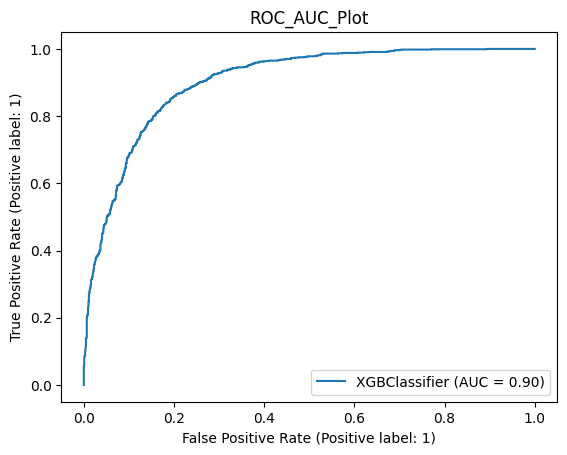

In [53]:
model(classifier_xgb,x_train,y_train,x_test,y_test)

              precision    recall  f1-score   support

           0       0.86      0.78      0.82      1062
           1       0.79      0.87      0.83      1004

    accuracy                           0.82      2066
   macro avg       0.83      0.83      0.82      2066
weighted avg       0.83      0.82      0.82      2066



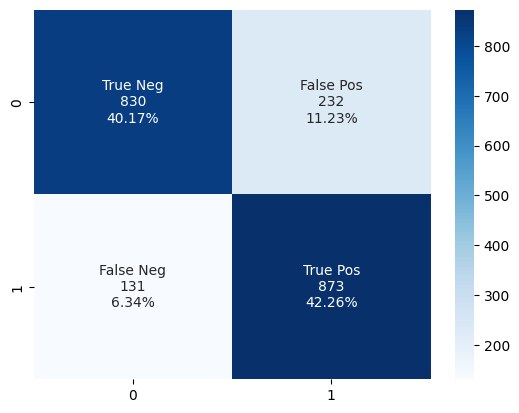

In [54]:
model_evaluation(classifier_xgb,x_test,y_test)

2] LightGBM Classifier :

In [55]:
!pip install lightgbm

     ---------------------------------------- 1.4/1.4 MB 10.2 MB/s eta 0:00:00



[notice] A new release of pip available: 22.2.1 -> 24.1.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [56]:
from lightgbm import LGBMClassifier

classifier_lgbm = LGBMClassifier(learning_rate= 0.01,max_depth = 3,n_estimators = 1000)

[LightGBM] [Info] Number of positive: 4159, number of negative: 4101
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000395 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1324
[LightGBM] [Info] Number of data points in the train set: 8260, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.503511 -> initscore=0.014044
[LightGBM] [Info] Start training from score 0.014044
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

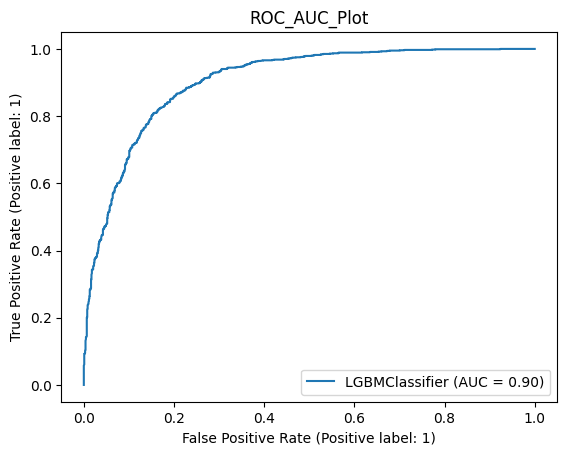

In [57]:
model(classifier_lgbm,x_train,y_train,x_test,y_test)

              precision    recall  f1-score   support

           0       0.87      0.78      0.82      1062
           1       0.79      0.87      0.83      1004

    accuracy                           0.83      2066
   macro avg       0.83      0.83      0.83      2066
weighted avg       0.83      0.83      0.83      2066



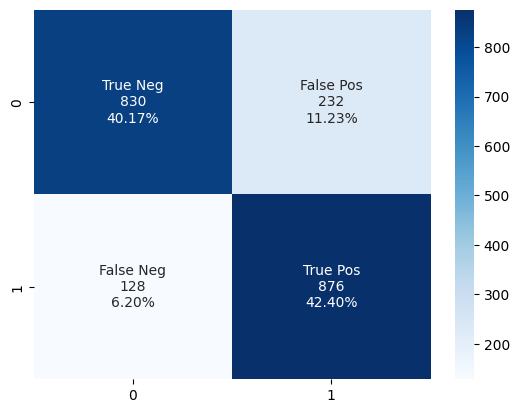

In [58]:
model_evaluation(classifier_lgbm,x_test,y_test)

3] Random Forest Classifier :

In [59]:
from sklearn.ensemble import RandomForestClassifier

In [60]:
classifier_rf = RandomForestClassifier(max_depth = 4,random_state = 0)

Cross Validation Score :  85.74%
ROC_AUC Score :  78.18%


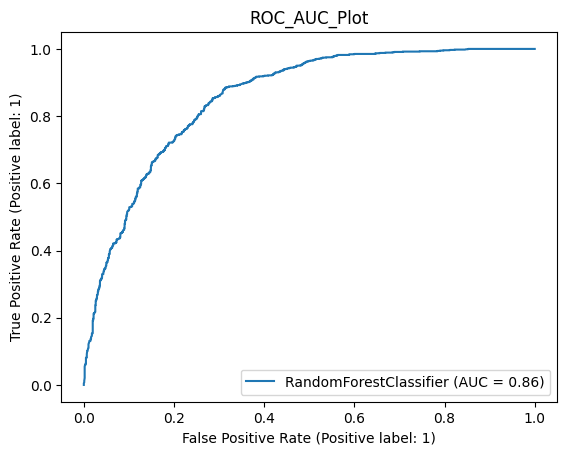

In [62]:
model(classifier_rf,x_train,y_train,x_test,y_test)

              precision    recall  f1-score   support

           0       0.84      0.71      0.77      1062
           1       0.74      0.85      0.79      1004

    accuracy                           0.78      2066
   macro avg       0.79      0.78      0.78      2066
weighted avg       0.79      0.78      0.78      2066



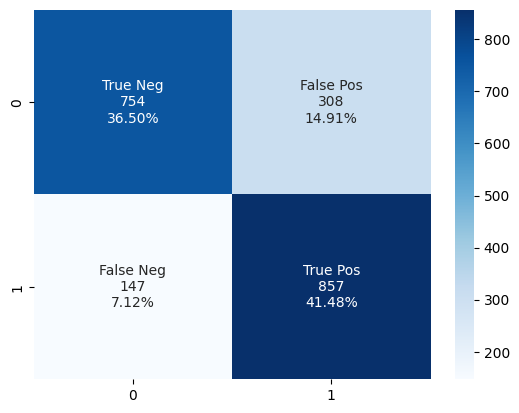

In [63]:
model_evaluation(classifier_rf,x_test,y_test)

4] Decision Tree Classifier :

In [64]:
from sklearn.tree import DecisionTreeClassifier

In [65]:
classifier_dt = DecisionTreeClassifier(random_state = 1000,max_depth = 4,min_samples_leaf = 1)

Cross Validation Score :  84.04%
ROC_AUC Score :  77.22%


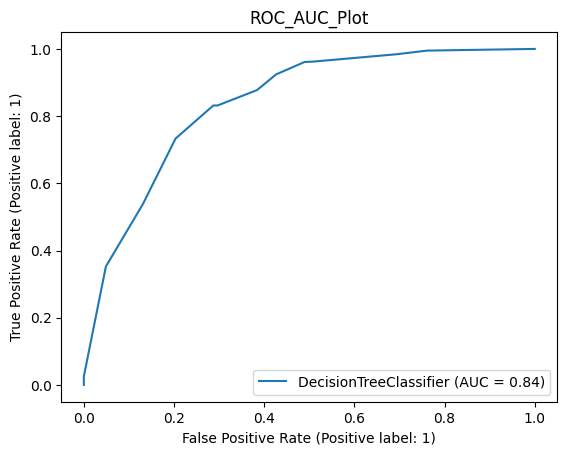

In [66]:
model(classifier_dt,x_train,y_train,x_test,y_test)

5] Stack of XGBClassifier, LightGBMClassifier, Random Forest Classifer & Decision Tree Classifier :

In [67]:
from sklearn.ensemble import StackingClassifier

stack = StackingClassifier(estimators = [('classifier_xgb',classifier_xgb),
                                         ('classifier_lgbm',classifier_lgbm),
                                         ('classifier_rf',classifier_rf),
                                         ('classifier_dt',classifier_dt)],
                           final_estimator = classifier_lgbm)

[LightGBM] [Info] Number of positive: 4159, number of negative: 4101
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000288 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1324
[LightGBM] [Info] Number of data points in the train set: 8260, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.503511 -> initscore=0.014044
[LightGBM] [Info] Start training from score 0.014044
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

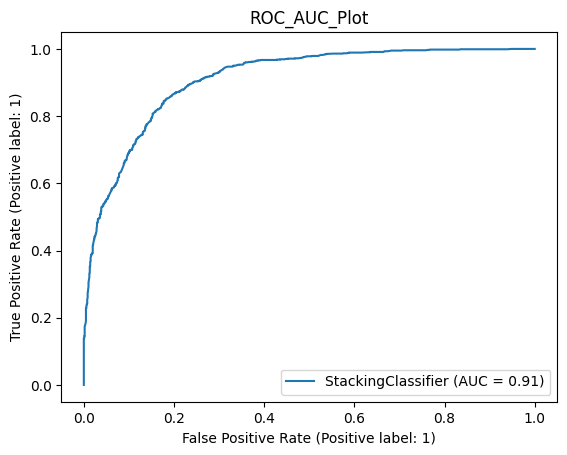

In [68]:
model(stack,x_train,y_train,x_test,y_test)

              precision    recall  f1-score   support

           0       0.85      0.82      0.83      1062
           1       0.82      0.85      0.83      1004

    accuracy                           0.83      2066
   macro avg       0.83      0.83      0.83      2066
weighted avg       0.83      0.83      0.83      2066



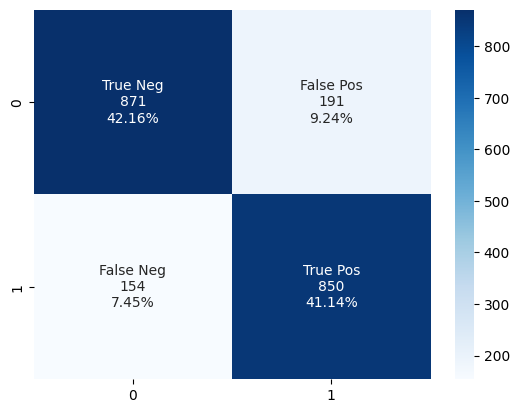

In [69]:
model_evaluation(stack,x_test,y_test)

|  Sr.No.  |	   ML Algorithm	               |  Cross Validation Score  |	    ROC AUC Score |	  F1 Score (Churn) |
|  :-----: |       :-----:                     |     :-----:              |       :-----:     |      :-----:       |
|  1	   |    XGBClassifier	               |    90.17%	              |          82.63%	  |     83%            |
|  2	   |    LightGBMClassifier	           |    90.33%	              |          82.87%	  |     83%            |    
|  3	   |    RandomForestClassifier         |    85.69%	              |          79.12%	  |     80%            | 
|  4	   |    DecisionTreeClassifier	       |    84.29%	              |          76.53%	  |     79%            |
|  5	   |    Stack of All 4 Classifiers     |    90.88%	              |          83.01%	  |     83%            | 